In [1]:
import json
import sys
from collections import Counter
from itertools import cycle
from pathlib import Path

import dabest
import matplotlib.pyplot as plt
import seaborn as sns
import mne
import numpy as np
import pandas as pd
import statsmodels.api as sm
import yaml

from mne.time_frequency import tfr_morlet, psd_multitaper, psd_welch
from mne_bids.read import read_raw_bids
from mne_bids import BIDSPath
from ptitprince import PtitPrince as pt
from rerf.rerfClassifier import rerfClassifier
from scipy.io import loadmat
from scipy.spatial.distance import euclidean
from scipy import stats
from sklearn.dummy import DummyClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.inspection import permutation_importance
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import (
    auc, 
    accuracy_score, 
    cohen_kappa_score, 
    make_scorer, 
    plot_confusion_matrix, 
    roc_auc_score, 
    roc_curve
)
from sklearn.model_selection import train_test_split, KFold, StratifiedKFold, TimeSeriesSplit
from sklearn.preprocessing import MinMaxScaler, LabelBinarizer, label_binarize
from sklearn.utils import check_random_state
from tqdm import tqdm

from move_experiment_functions import (
    fit_classifiers_cv, 
    get_event_data, 
    get_event_durations, 
    get_preprocessed_labels,
    bootstrap_independence_test,
)

if os.path.abspath("../io") not in sys.path:
    sys.path.append(os.path.abspath("../io"))

from read import read_dataset, read_trial, get_trial_info
from utils import NumpyEncoder
from experiments import run_classifier_comparison, cv_fit
from plotting import (
    plot_roc_multiclass_cv,
    plot_feature_importances,
    plot_cv_indices, 
    plot_classifier_performance,
    plot_roc_aucs,
    plot_accuracies,
    plot_event_onsets,
    plot_event_durations
)

# plt.style.use(['science', 'ieee', 'no-latex'])
plt.rcParams["font.family"] = "sans-serif"

%load_ext autoreload
%autoreload 2
%matplotlib inline

In [2]:
with open(Path(os.path.abspath('')) / "config.yml") as f:
    config = yaml.load(f, Loader=yaml.FullLoader)

with open(Path(os.path.abspath('')) / "metadata.yml") as f:
    metadata = yaml.load(f, Loader=yaml.FullLoader)

subjects = metadata["subjects"]

bids_root = Path(config["bids_root"])
results_path = Path(config["results_path"])

print(f"bids_root: {bids_root}")
print(f"results_path: {results_path}")

bids_root: /Volumes/Mac/research/data/efri
results_path: /Users/ChesterHuynh/Johns Hopkins/Adam Li - efri/derivatives/workstation_output


In [3]:
nfreqs = 10
lfreq, hfreq = (70, 200)
freqs = np.logspace(*np.log10([lfreq, hfreq]), num=nfreqs)
n_cycles = freqs / 3.0

rng = 1
n_splits = 5
cv = StratifiedKFold(n_splits)
metrics = dict(
    accuracy="accuracy",
    cohen_kappa_score=make_scorer(cohen_kappa_score),
    roc_auc_ovr="roc_auc_ovr",
)

label_names = {0: "Down", 1: "Right", 2: "Up", 3: "Left"}

## Event durations/onsets

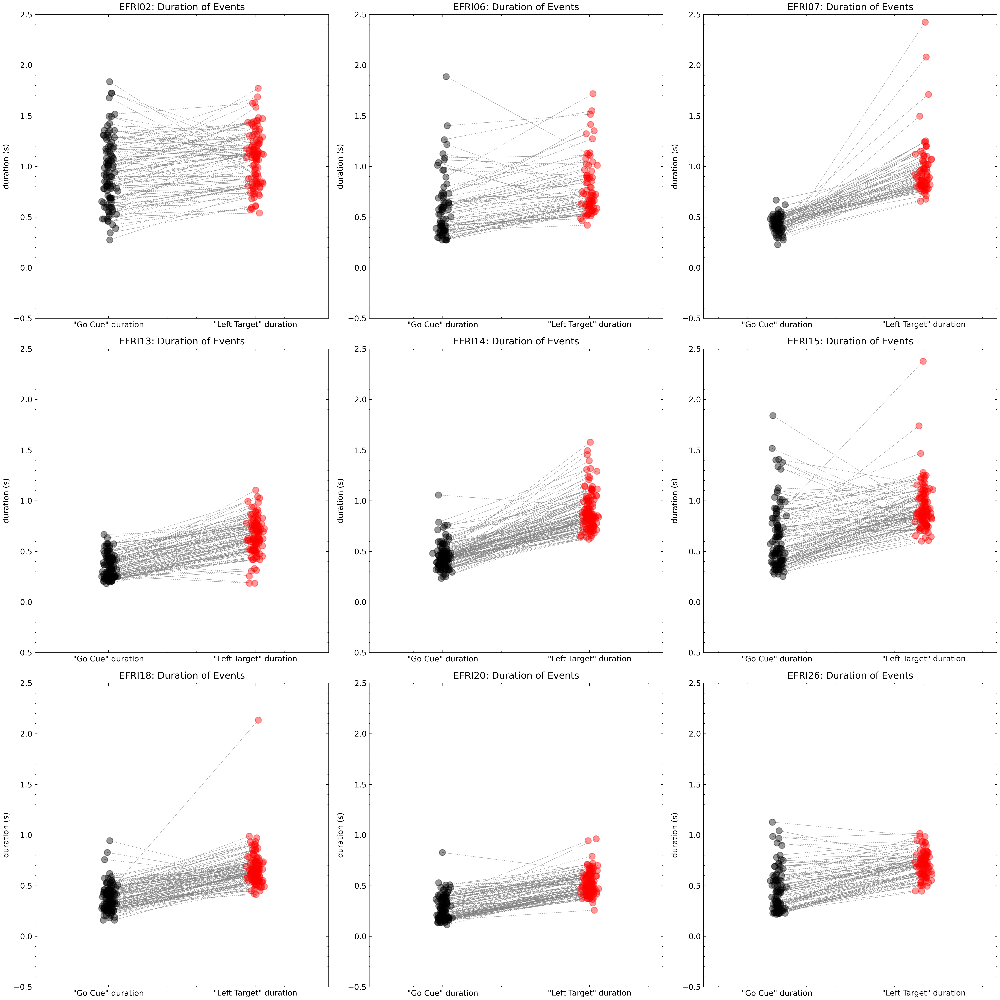

In [52]:
fig, axs = plt.subplots(nrows=3, ncols=3, dpi=300, figsize=(18, 18))
axs = axs.flatten()

for subject, ax in zip(subjects, axs):
    path_identifiers = dict(subject=subject, session="efri", task="move", 
                            acquisition="seeg", run="01", suffix="ieeg", 
                            extension=".vhdr", root=bids_root)
    bids_path = BIDSPath(**path_identifiers)
    
    behav, events = map(pd.DataFrame, get_trial_info(bids_path))
    plot_event_durations(behav, events, ax=ax, random_state=rng)

    ax.set(ylabel="duration (s)", title=f"{subject.upper()}: Duration of Events")

fig.tight_layout();

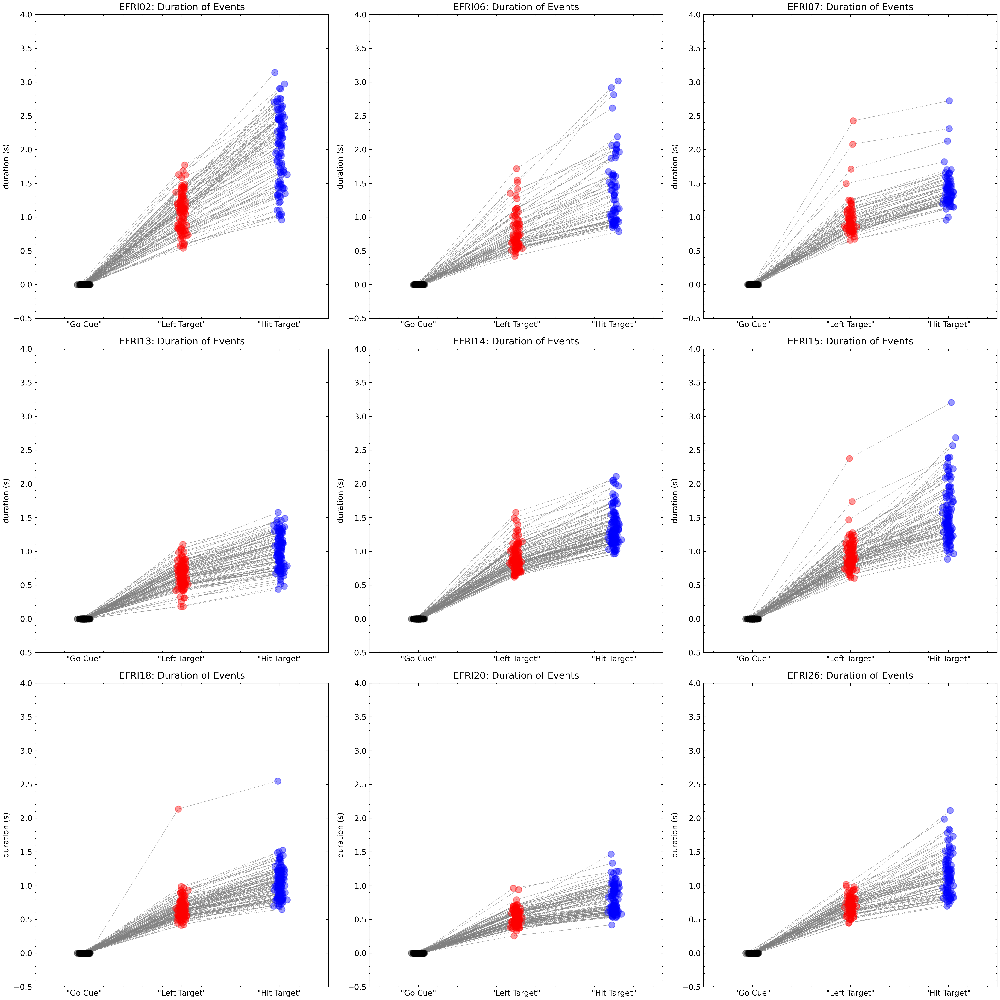

In [53]:
fig, axs = plt.subplots(nrows=3, ncols=3, dpi=300, figsize=(18, 18))
axs = axs.flatten()

for subject, ax in zip(subjects, axs):
    path_identifiers = dict(subject=subject, session="efri", task="move", 
                            acquisition="seeg", run="01", suffix="ieeg", 
                            extension=".vhdr", root=bids_root)
    bids_path = BIDSPath(**path_identifiers)
    
    behav, events = map(pd.DataFrame, get_trial_info(bids_path))
    plot_event_onsets(behav, events, ax=ax, random_state=rng)

    ax.set(ylabel="duration (s)", title=f"{subject.upper()}: Duration of Events")

fig.tight_layout();

## Time durations grouped by label

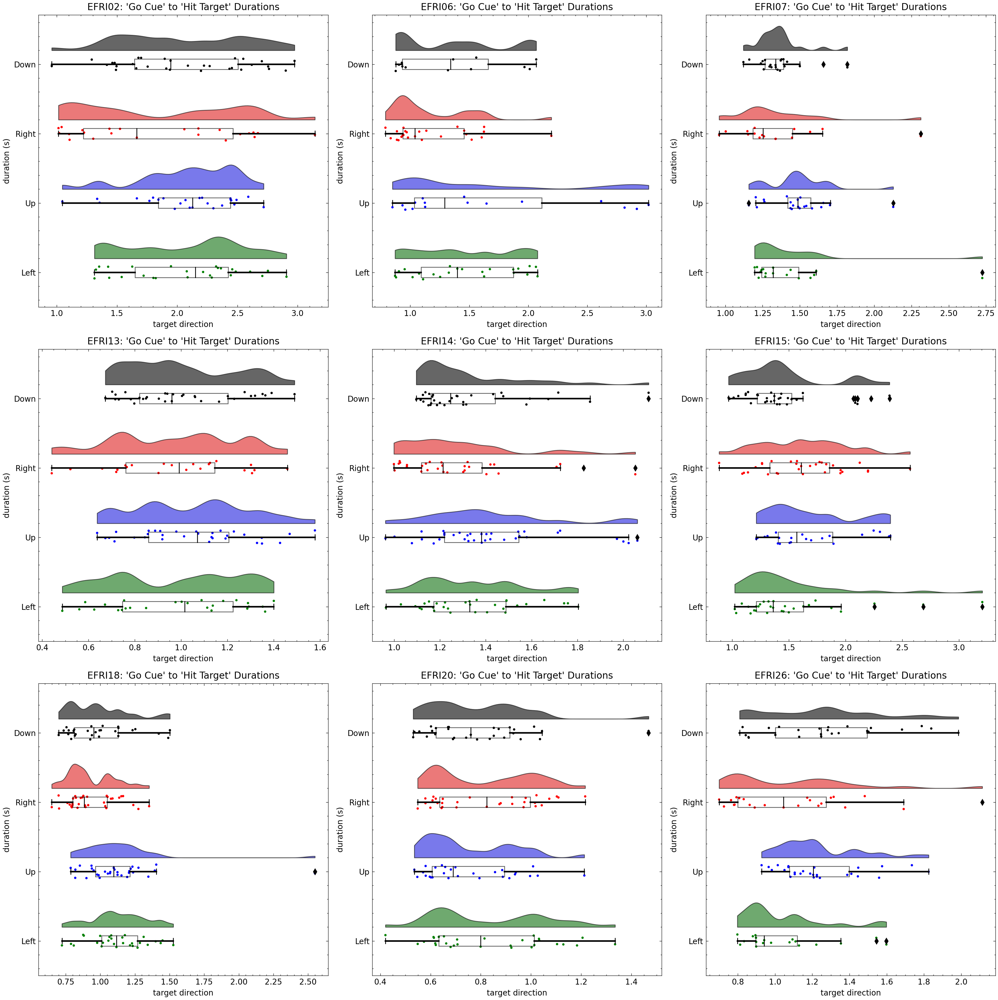

In [54]:
fig, axs = plt.subplots(nrows=3, ncols=3, dpi=200, figsize=(18, 18))
axs = axs.flatten()

for subject, ax in zip(subjects, axs):
    path_identifiers = dict(subject=subject, session="efri", task="move", 
                            acquisition="seeg", run="01", suffix="ieeg", 
                            extension=".vhdr", root=bids_root)
    bids_path = BIDSPath(**path_identifiers)

    # compute length of time window for go cue to hit target
    go_cue_durations = get_event_durations(bids_path, event_key="Left Target", periods=-1)
    left_target_durations = get_event_durations(bids_path, event_key="Left Target", periods=1)
    total_durations = go_cue_durations + left_target_durations

    labels = get_preprocessed_labels(bids_path, label_keyword="target_direction")
    durations_df = pd.DataFrame(dict(durations=total_durations, labels=labels))
    
    # plot rain clouds
    pt.RainCloud(
        x="labels", y="durations", palette=None, data=durations_df, orient="h", alpha=0.6, ax=ax
    )
    ax.set(
        title=f"{subject.upper()}: 'Go Cue' to 'Hit Target' Durations", 
        xlabel="target direction",
        ylabel="duration (s)", 
        yticklabels=["Down", "Right", "Up", "Left"]
    )

fig.tight_layout();

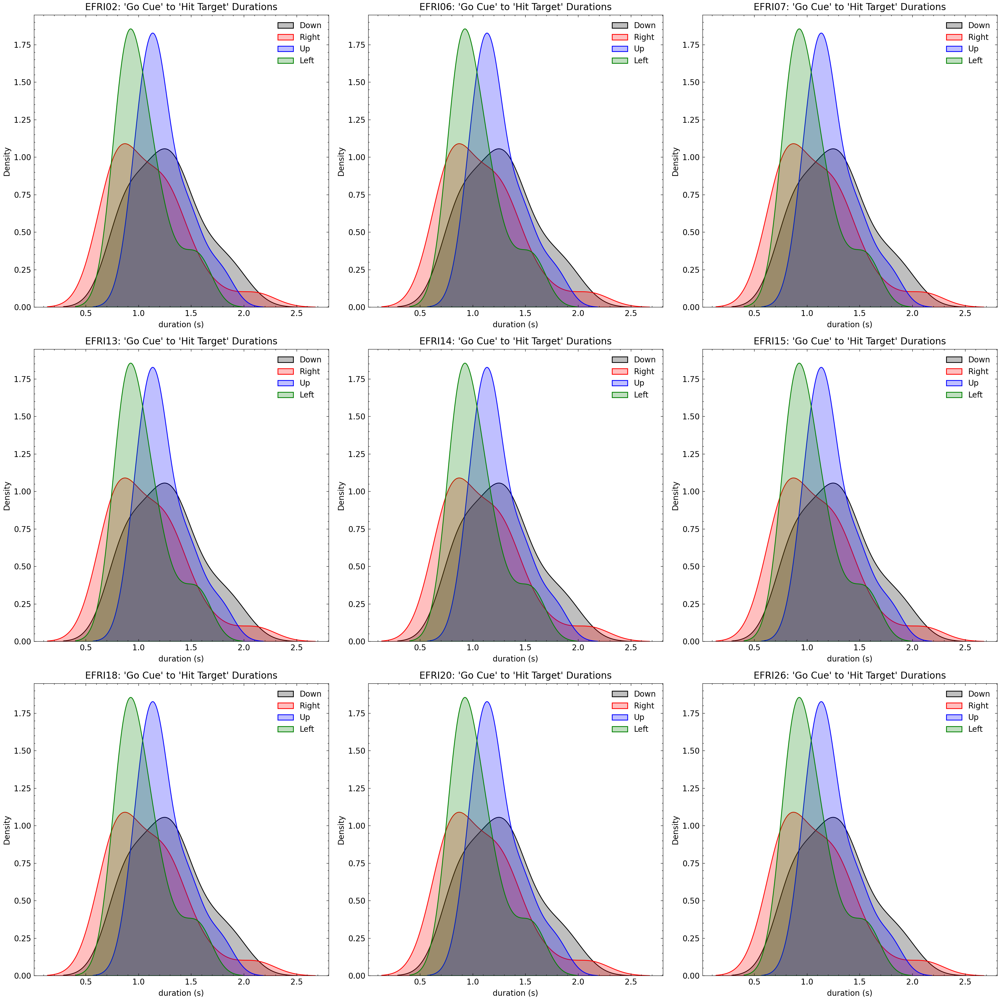

In [55]:
fig, axs = plt.subplots(nrows=3, ncols=3, dpi=200, figsize=(18, 18))
axs = axs.flatten()

for subject, ax in zip(subjects, axs):
    path_identifiers = dict(subject=subject, session="efri", task="move", 
                            acquisition="seeg", run="01", suffix="ieeg", 
                            extension=".vhdr", root=bids_root)
    bids_path = BIDSPath(**path_identifiers)

    # compute length of time window for go cue to hit target
    go_cue_durations = get_event_durations(bids_path, event_key="Left Target", periods=-1)
    left_target_durations = get_event_durations(bids_path, event_key="Left Target", periods=1)
    total_durations = go_cue_durations + left_target_durations

    labels = get_preprocessed_labels(bids_path, label_keyword="target_direction")
    durations_df = pd.DataFrame(dict(durations=total_durations, labels=labels))

    # plot kde plots
    for label, group in cue_target_duration.groupby('labels'):
        sns.distplot(
            group.durations, 
            hist=False, hist_kws=dict(alpha=0.3), 
            kde=True, kde_kws=dict(fill=True, palette='crest'), 
            label=label_names[label], 
            ax=ax
        )
    
    ax.legend()
    ax.set(
        title=f"{subject.upper()}: 'Go Cue' to 'Hit Target' Durations", 
        xlabel="duration (s)", 
    )

fig.tight_layout();

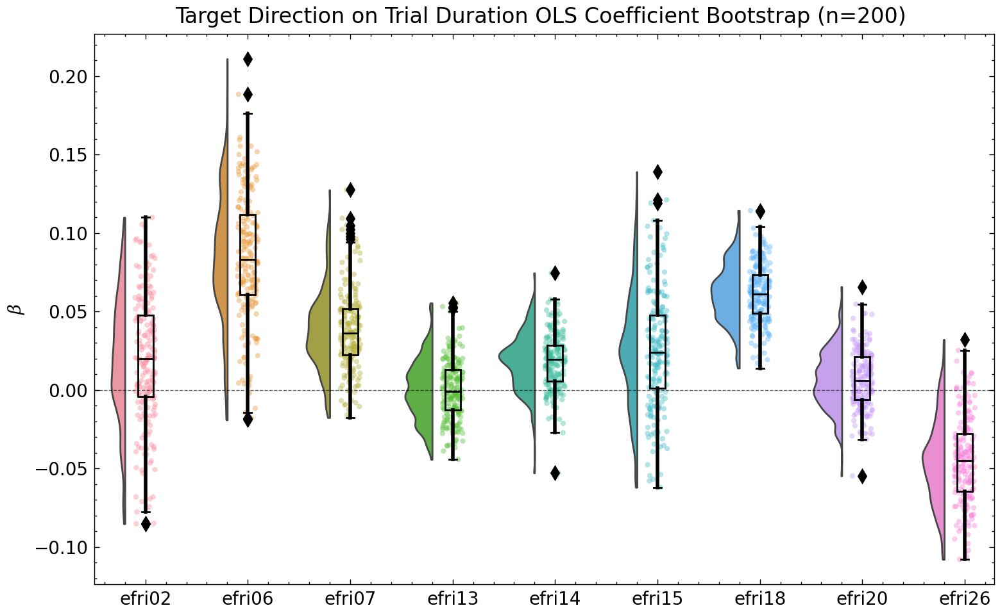

In [85]:
estimates_df = pd.DataFrame(columns=['estimates', 'subjects'])
num_bootstraps = 200
for i, subject in enumerate(subjects):
    path_identifiers = dict(subject=subject, session="efri", task="move", 
                            acquisition="seeg", run="01", suffix="ieeg", 
                            extension=".vhdr", root=bids_root)
    bids_path = BIDSPath(**path_identifiers)

    # compute length of time window for go cue to hit target
    go_cue_durations = get_event_durations(bids_path, event_key="Left Target", periods=-1)
    left_target_durations = get_event_durations(bids_path, event_key="Left Target", periods=1)
    total_durations = go_cue_durations + left_target_durations

    labels = get_preprocessed_labels(bids_path, label_keyword="target_direction")
    durations_df = pd.DataFrame(dict(durations=total_durations, labels=labels))

    # bootstrap estimate for regression coefficient between label and duration
    _, _, estimates = bootstrap_independence_test(
        X=durations_df.labels, y=durations_df.durations, num_bootstraps = 200, random_state=rng
    )

    bootstrap_estimates = pd.DataFrame(dict(estimates=estimates, subjects=subject))
    estimates_df = estimates_df.append(bootstrap_estimates)

fig, ax = plt.subplots(dpi=200, figsize=(8, 5))

# plot regression coefficient estimates
pt.RainCloud(x="subjects", y="estimates", palette=None, data=estimates_df, cloud_alpha=.4, rain_alpha=0.4, ax=ax)
ax.axhline(y=0, lw=0.5, ls="--", alpha=0.6)
ax.set(
    title=f"Target Direction on Trial Duration OLS Coefficient Bootstrap (n={num_bootstraps}) ",
    xlabel="",
    ylabel=r"$\beta$",
)

fig.tight_layout();

## Globally shortest time window

In [86]:
def get_shortest_event_durations(bids_root, subjects, label_keyword="Left Target"):
    before_duration = np.inf
    after_duration = np.inf
    for subject in subjects:
        path_identifiers = dict(subject=subject, session="efri", task="move", 
                            acquisition="seeg", run="01", suffix="ieeg", 
                            extension=".vhdr", root=bids_root)
        bids_path = BIDSPath(**path_identifiers)

        go_cue_duration = get_event_durations(bids_path, event_key="Left Target", periods=-1)
        left_target_duration = get_event_durations(bids_path, event_key="Left Target", periods=1)

        # update durations if one of the durations for this patient is shorter
        before_duration = min(before_duration, min(go_cue_duration))
        after_duration = min(after_duration, min(left_target_duration))
    
    return before_duration, after_duration

In [87]:
before_duration, after_duration = get_shortest_event_durations(bids_root, subjects)

tmin = -before_duration
tmax = after_duration
print(tmin, tmax)

-0.1150000000000091 0.18650000000002365


In [15]:
data = dict()
subject_clf_scores = dict()

for subject in tqdm(subjects):
    path_identifiers = dict(subject=subject, session="efri", task="move", 
                            acquisition="seeg", run="01", suffix="ieeg", 
                            extension=".vhdr", root=bids_root)
    bids_path = BIDSPath(**path_identifiers)
    epochs, labels = get_event_data(bids_path, tmin=tmin-0.25, tmax=tmax+0.25)

    power = tfr_morlet(epochs, freqs=freqs, n_cycles=n_cycles, average=False, return_itc=False, decim=3, n_jobs=-1)
    power.crop(tmin=tmin, tmax=tmax)

    power_data = power.data
    ntrials, nchs, nfreqs, nsteps = power_data.shape
    print(ntrials, nchs, nfreqs, nsteps)
    image_height = nchs * nfreqs
    image_width = nsteps

    X = power_data.reshape(ntrials, -1)
    y = labels

    data[subject] = (X, y)

    subject_clf_scores[subject] = fit_classifiers_cv(X, y, image_height, image_width, cv, metrics, random_state=rng)

ri06_ses-efri_task-move_acq-seeg_run-01_channels.tsv.
Reading 0 ... 2525999  =      0.000 ...  1262.999 secs...
Setting up band-stop filter

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower transition bandwidth: 0.50 Hz
- Upper transition bandwidth: 0.50 Hz
- Filter length: 13201 samples (6.601 sec)

Used Annotations descriptions: ['At Center', 'False Start', 'Go Cue', 'Held Target', 'Hit Target', 'Leave Target', 'Left Target', 'Reserved (End Trial)', 'Reserved (Start Trial)', 'Reward', 'Show Center', 'Speed Fail', 'Speed Feedback', 'Speed Instruction']
Not setting metadata
Not setting metadata
94 matching events found
No baseline correction applied
0 projection items activated
Loading data for 94 events and 1604 original time points ...
0 bad epochs dropped
Setting up band-pass filter from 1 - 1e+03 H

  0%|          | 0/9 [00:00<?, ?it/s]

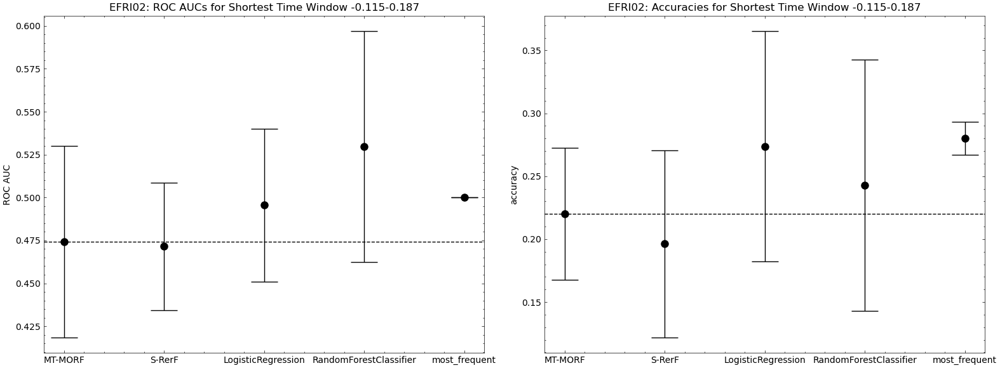

 11%|█         | 1/9 [00:01<00:10,  1.35s/it]Figure saved at /Users/ChesterHuynh/Johns Hopkins/Adam Li - efri/derivatives/workstation_output/efri02/efri02_time_window_tmin=-0.115_tmax=0.187_freq_domain.png


<Figure size 432x288 with 0 Axes>

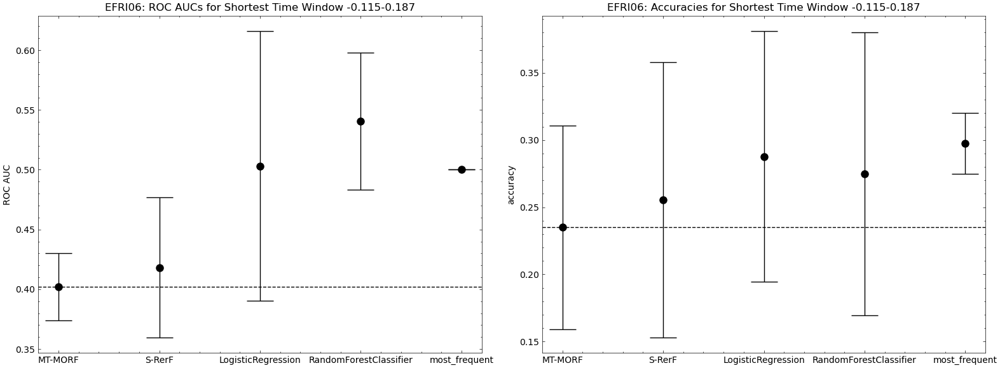

 22%|██▏       | 2/9 [00:02<00:08,  1.19s/it]Figure saved at /Users/ChesterHuynh/Johns Hopkins/Adam Li - efri/derivatives/workstation_output/efri06/efri06_time_window_tmin=-0.115_tmax=0.187_freq_domain.png


<Figure size 432x288 with 0 Axes>

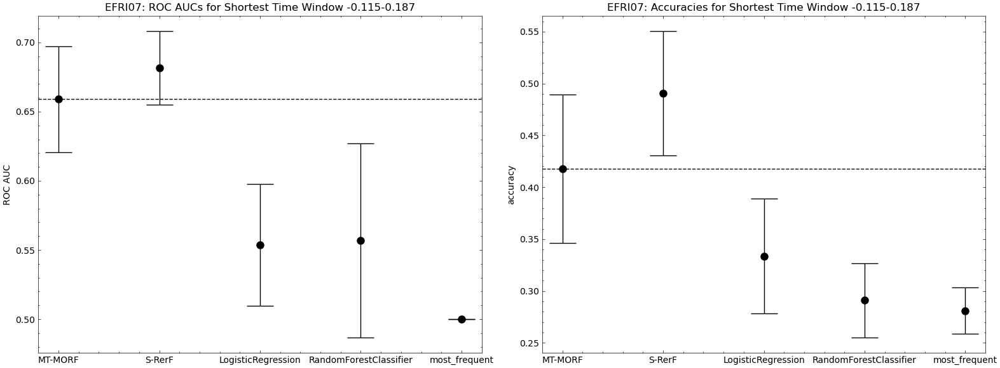

 33%|███▎      | 3/9 [00:03<00:06,  1.17s/it]Figure saved at /Users/ChesterHuynh/Johns Hopkins/Adam Li - efri/derivatives/workstation_output/efri07/efri07_time_window_tmin=-0.115_tmax=0.187_freq_domain.png


<Figure size 432x288 with 0 Axes>

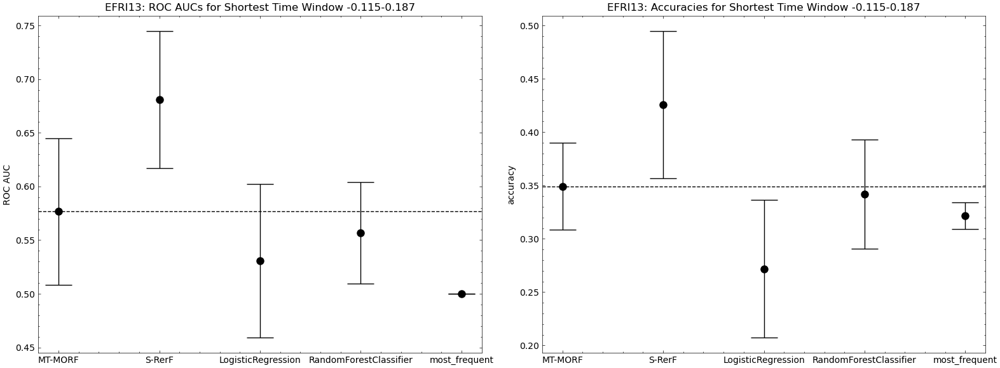

 44%|████▍     | 4/9 [00:04<00:05,  1.19s/it]Figure saved at /Users/ChesterHuynh/Johns Hopkins/Adam Li - efri/derivatives/workstation_output/efri13/efri13_time_window_tmin=-0.115_tmax=0.187_freq_domain.png


<Figure size 432x288 with 0 Axes>

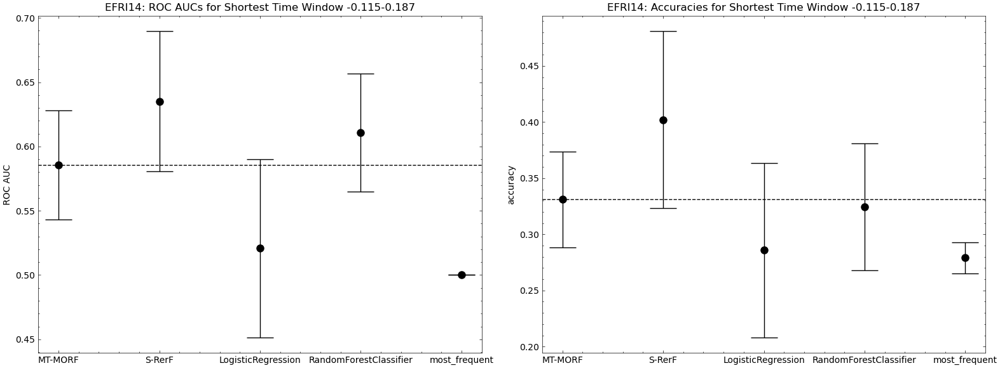

 56%|█████▌    | 5/9 [00:05<00:04,  1.19s/it]Figure saved at /Users/ChesterHuynh/Johns Hopkins/Adam Li - efri/derivatives/workstation_output/efri14/efri14_time_window_tmin=-0.115_tmax=0.187_freq_domain.png


<Figure size 432x288 with 0 Axes>

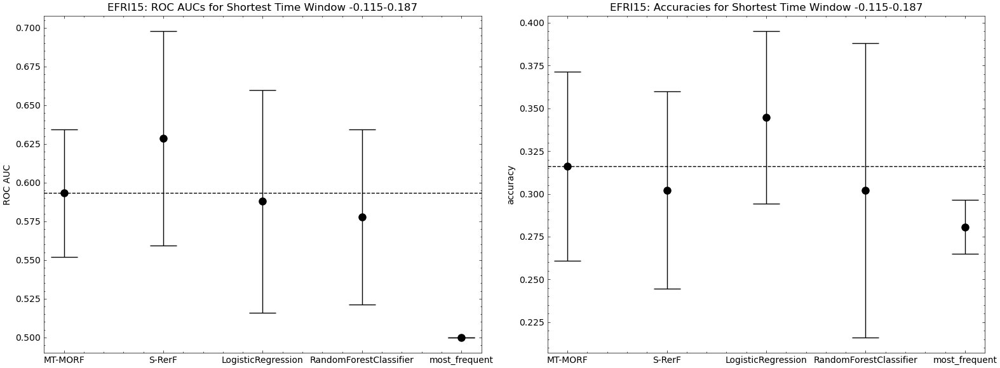

 67%|██████▋   | 6/9 [00:07<00:03,  1.24s/it]Figure saved at /Users/ChesterHuynh/Johns Hopkins/Adam Li - efri/derivatives/workstation_output/efri15/efri15_time_window_tmin=-0.115_tmax=0.187_freq_domain.png


<Figure size 432x288 with 0 Axes>

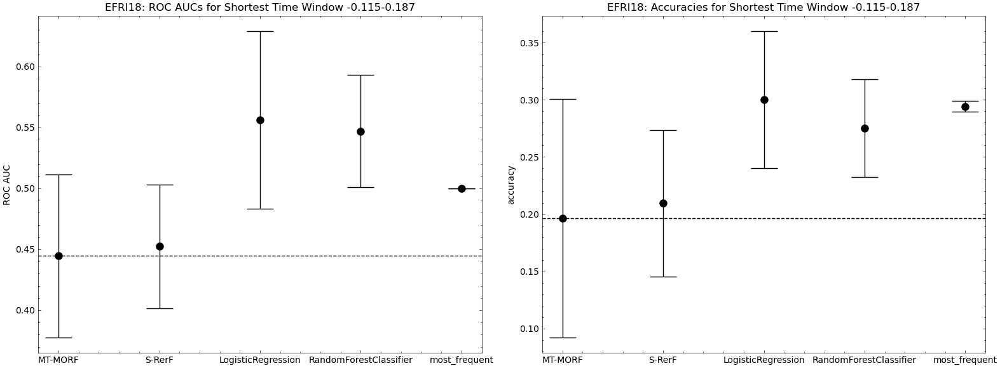

 78%|███████▊  | 7/9 [00:08<00:02,  1.23s/it]Figure saved at /Users/ChesterHuynh/Johns Hopkins/Adam Li - efri/derivatives/workstation_output/efri18/efri18_time_window_tmin=-0.115_tmax=0.187_freq_domain.png


<Figure size 432x288 with 0 Axes>

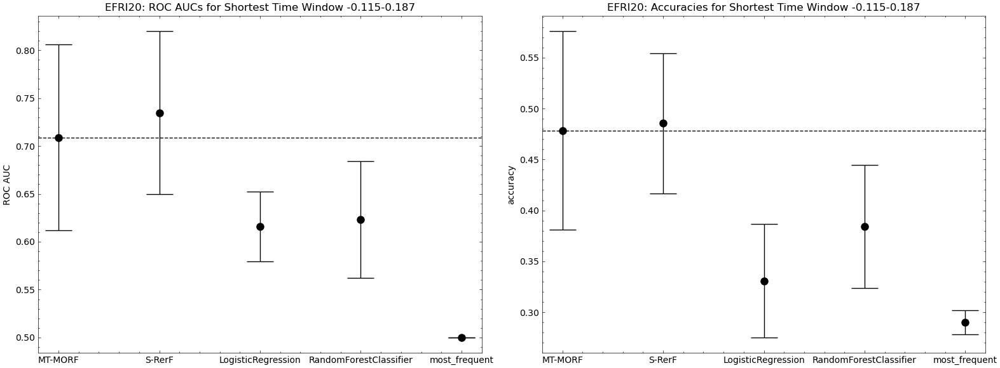

 89%|████████▉ | 8/9 [00:09<00:01,  1.23s/it]Figure saved at /Users/ChesterHuynh/Johns Hopkins/Adam Li - efri/derivatives/workstation_output/efri20/efri20_time_window_tmin=-0.115_tmax=0.187_freq_domain.png


<Figure size 432x288 with 0 Axes>

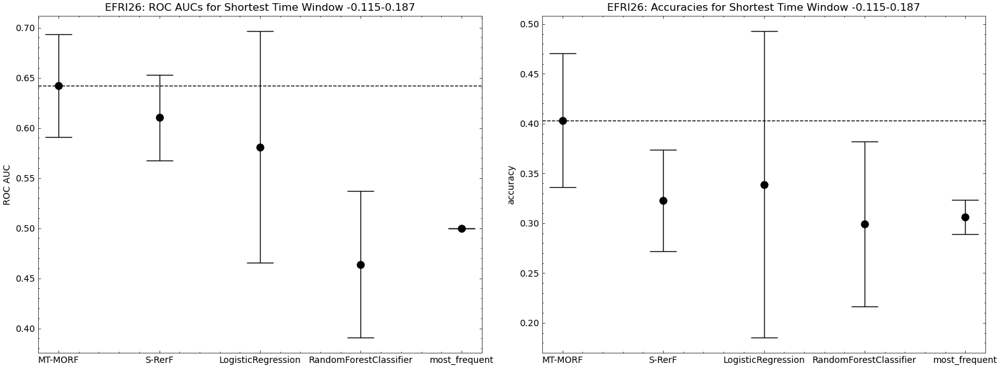

100%|██████████| 9/9 [00:11<00:00,  1.24s/it]Figure saved at /Users/ChesterHuynh/Johns Hopkins/Adam Li - efri/derivatives/workstation_output/efri26/efri26_time_window_tmin=-0.115_tmax=0.187_freq_domain.png



<Figure size 432x288 with 0 Axes>

In [16]:
for subject, clf_scores in subject_clf_scores.items():

    destination = results_path / subject

    X, y = data[subject]

    fig, axs = plt.subplots(ncols=2, dpi=100, figsize=(16, 6))
    axs = axs.flatten()
    
    # 1. Plot accuracies
    plot_accuracies(clf_scores, ax=axs[1])
    axs[0].set(
        ylabel="accuracy",
        title=f"{subject.upper()}: Accuracies for Shortest Time Window {tmin:.3f}-{tmax:.3f}",
    )
    
    # 2. Plot ROC AUCs
    plot_roc_aucs(clf_scores, ax=axs[0])
    axs[1].set(
        ylabel="ROC AUC",
        title=f"{subject.upper()}: ROC AUCs for Shortest Time Window {tmin:.3f}-{tmax:.3f}",
    )

    fig.tight_layout()

    plt.show()

    plt.savefig(destination / f"{subject}_time_window_tmin={tmin:.3f}_tmax={tmax:.3f}_freq_domain.png")
    plt.close(fig)
    print(f"Figure saved at {destination}/{subject}_time_window_tmin={tmin:.3f}_tmax={tmax:.3f}_freq_domain.png")

  0%|          | 0/9 [00:00<?, ?it/s]

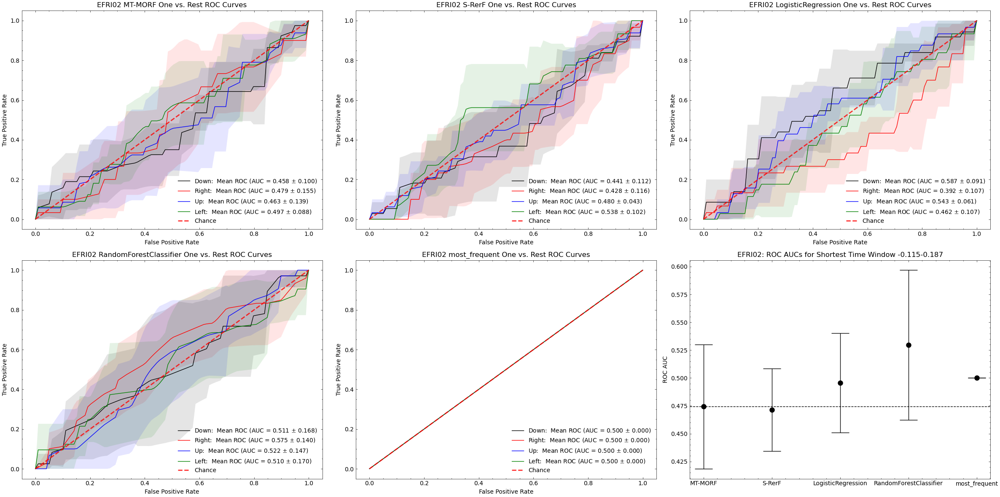

 11%|█         | 1/9 [00:05<00:45,  5.72s/it]Figure saved at /Users/ChesterHuynh/Johns Hopkins/Adam Li - efri/derivatives/workstation_output/efri02/efri02_time_window_tmin=-0.115_tmax=0.187_rocs_freq_domain.png


<Figure size 432x288 with 0 Axes>

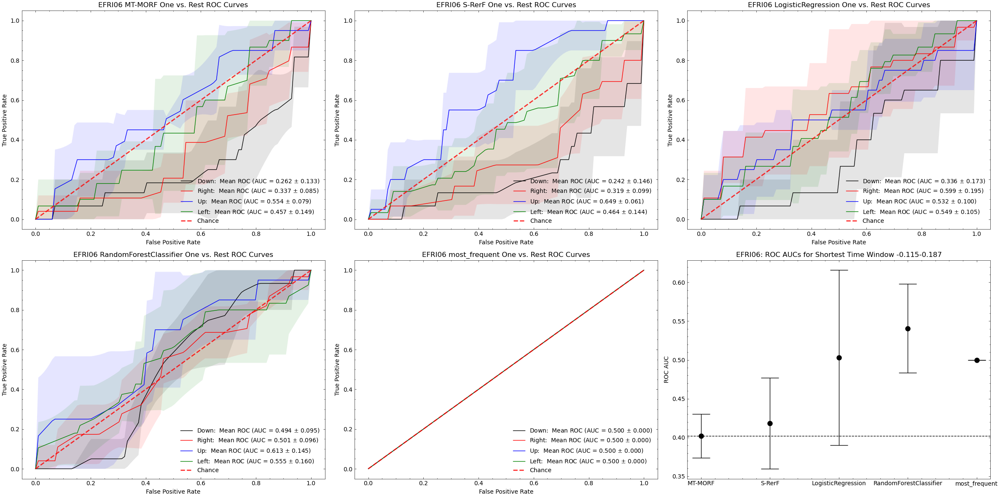

 22%|██▏       | 2/9 [00:11<00:38,  5.47s/it]Figure saved at /Users/ChesterHuynh/Johns Hopkins/Adam Li - efri/derivatives/workstation_output/efri06/efri06_time_window_tmin=-0.115_tmax=0.187_rocs_freq_domain.png


<Figure size 432x288 with 0 Axes>

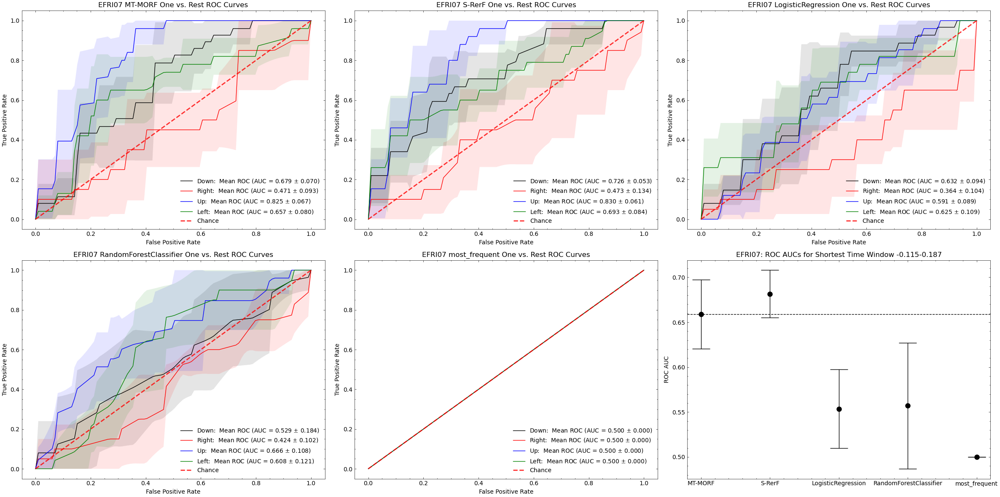

 33%|███▎      | 3/9 [00:16<00:32,  5.42s/it]Figure saved at /Users/ChesterHuynh/Johns Hopkins/Adam Li - efri/derivatives/workstation_output/efri07/efri07_time_window_tmin=-0.115_tmax=0.187_rocs_freq_domain.png


<Figure size 432x288 with 0 Axes>

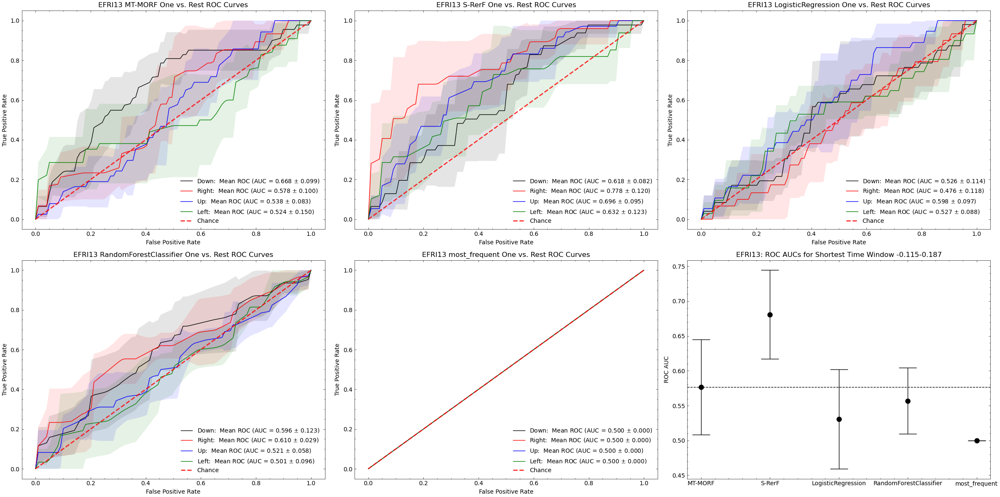

 44%|████▍     | 4/9 [00:21<00:27,  5.49s/it]Figure saved at /Users/ChesterHuynh/Johns Hopkins/Adam Li - efri/derivatives/workstation_output/efri13/efri13_time_window_tmin=-0.115_tmax=0.187_rocs_freq_domain.png


<Figure size 432x288 with 0 Axes>

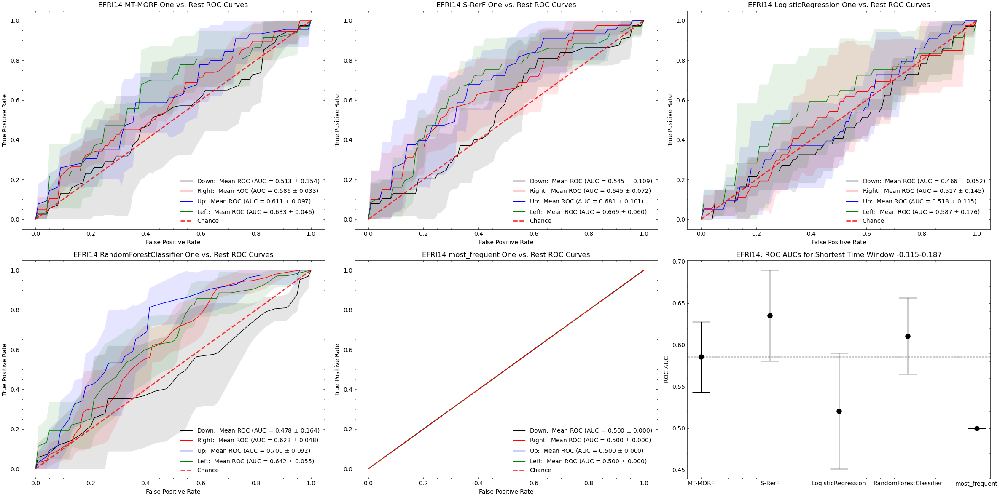

 56%|█████▌    | 5/9 [00:27<00:21,  5.49s/it]Figure saved at /Users/ChesterHuynh/Johns Hopkins/Adam Li - efri/derivatives/workstation_output/efri14/efri14_time_window_tmin=-0.115_tmax=0.187_rocs_freq_domain.png


<Figure size 432x288 with 0 Axes>

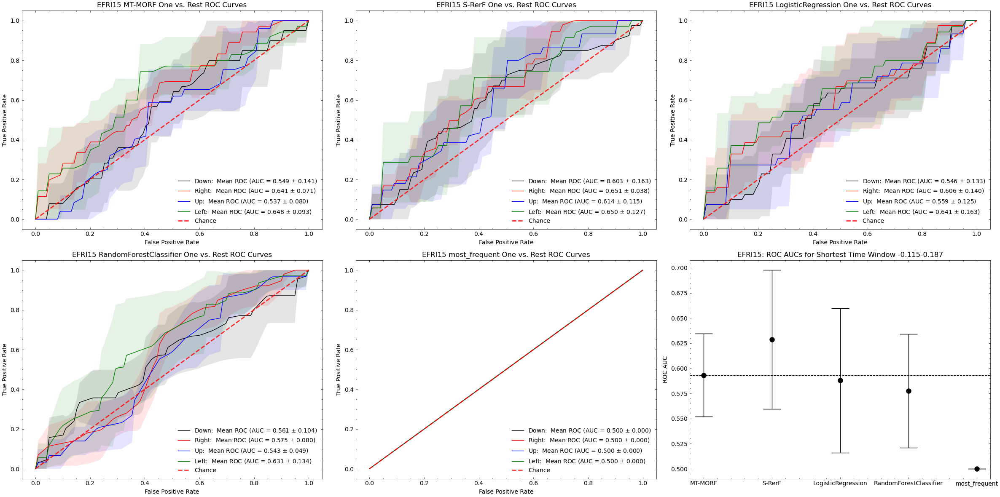

 67%|██████▋   | 6/9 [00:33<00:16,  5.53s/it]Figure saved at /Users/ChesterHuynh/Johns Hopkins/Adam Li - efri/derivatives/workstation_output/efri15/efri15_time_window_tmin=-0.115_tmax=0.187_rocs_freq_domain.png


<Figure size 432x288 with 0 Axes>

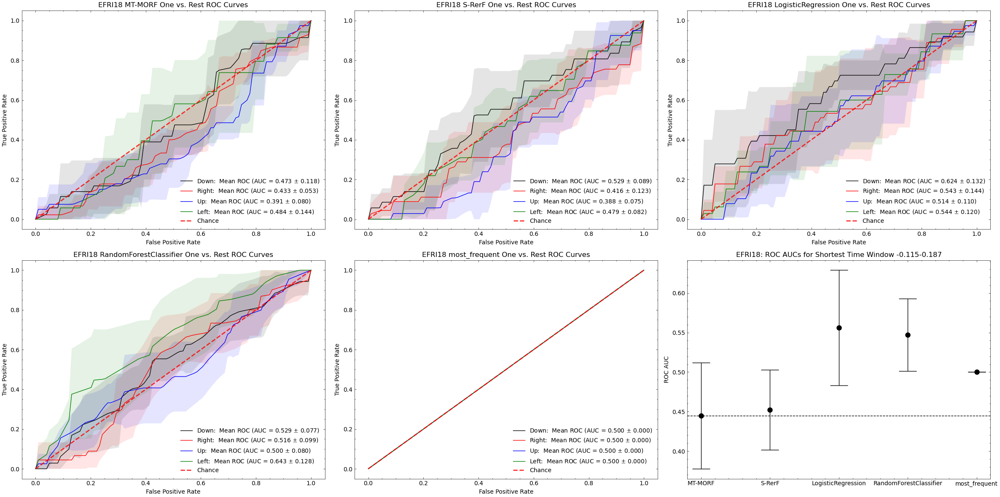

 78%|███████▊  | 7/9 [00:38<00:11,  5.56s/it]Figure saved at /Users/ChesterHuynh/Johns Hopkins/Adam Li - efri/derivatives/workstation_output/efri18/efri18_time_window_tmin=-0.115_tmax=0.187_rocs_freq_domain.png


<Figure size 432x288 with 0 Axes>

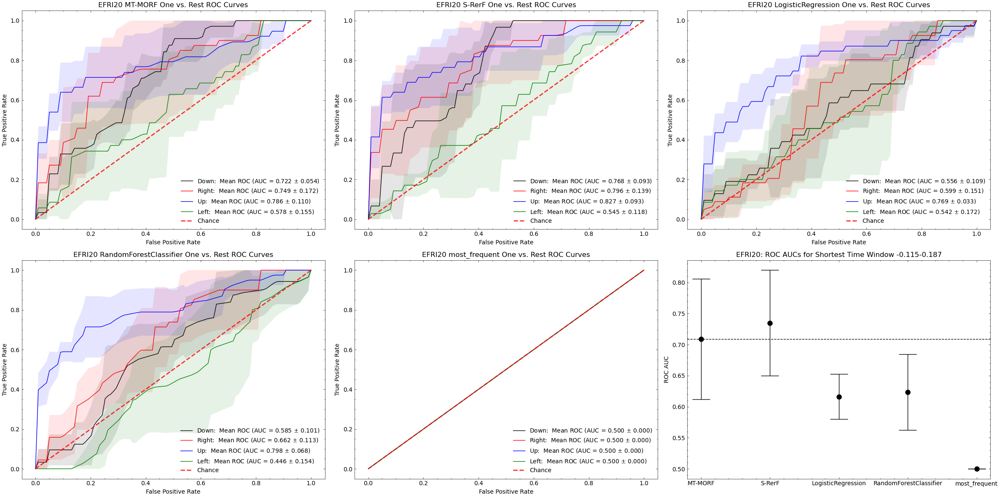

 89%|████████▉ | 8/9 [00:44<00:05,  5.62s/it]Figure saved at /Users/ChesterHuynh/Johns Hopkins/Adam Li - efri/derivatives/workstation_output/efri20/efri20_time_window_tmin=-0.115_tmax=0.187_rocs_freq_domain.png


<Figure size 432x288 with 0 Axes>

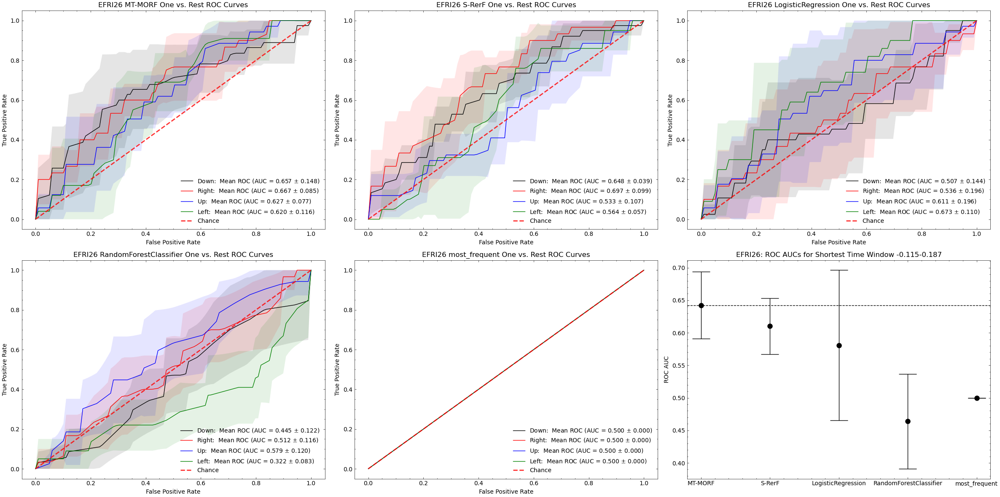

100%|██████████| 9/9 [00:50<00:00,  5.57s/it]Figure saved at /Users/ChesterHuynh/Johns Hopkins/Adam Li - efri/derivatives/workstation_output/efri26/efri26_time_window_tmin=-0.115_tmax=0.187_rocs_freq_domain.png



<Figure size 432x288 with 0 Axes>

In [17]:
for subject, clf_scores in subject_clf_scores.items():

    destination = results_path / subject

    X, y = data[subject]

    fig, axs = plt.subplots(nrows=2, ncols=3, dpi=100, figsize=(24, 12))
    axs = axs.flatten()
    for i, (clf_name, scores) in enumerate(clf_scores.items()):
        ax = axs[i]

        plot_roc_multiclass_cv(
            scores["test_predict_proba"],
            X,
            y,
            scores["test_inds"],
            ax=ax,
        )

        ax.set(
            xlabel="False Positive Rate",
            ylabel="True Positive Rate",
            xlim=[-0.05, 1.05],
            ylim=[-0.05, 1.05],
            title=f"{subject.upper()} {clf_name} One vs. Rest ROC Curves",
        )
        ax.legend(loc="lower right")
    
    plot_roc_aucs(clf_scores, ax=axs[-1])
    axs[-1].set(
        ylabel="ROC AUC",
        title=f"{subject.upper()}: ROC AUCs for Shortest Time Window {tmin:.3f}-{tmax:.3f}",
    )
    fig.tight_layout()

    plt.show()

    plt.savefig(destination / f"{subject}_time_window_tmin={tmin:.3f}_tmax={tmax:.3f}_rocs_freq_domain.png")
    plt.close(fig)
    print(f"Figure saved at {destination}/{subject}_time_window_tmin={tmin:.3f}_tmax={tmax:.3f}_rocs_freq_domain.png")

## Using patient-specific time-windows

### Shortest window

# Quality of results
- Both markedly non-trivial: efri07,  efri20,
- Both barely non-trivial: efri14, efri15, efri26
- One clf is trivial: efri02, efri13
- Both MT-MORF or S-ReRF is trivial: efri06, efri18

In [18]:
def get_shortest_event_durations_by_patient(bids_root, subjects, label_keyword="Left Target"):
    durations = dict()
    for subject in subjects:
        path_identifiers = dict(subject=subject, session="efri", task="move", 
                            acquisition="seeg", run="01", suffix="ieeg", 
                            extension=".vhdr", root=bids_root)
        bids_path = BIDSPath(**path_identifiers)

        go_cue_duration = get_event_durations(bids_path, event_key="Left Target", periods=-1)
        left_target_duration = get_event_durations(bids_path, event_key="Left Target", periods=1)

        # update durations
        before_duration = min(go_cue_duration)
        after_duration = min(left_target_duration)
        durations[subject] = (before_duration, after_duration)
    
    return durations

In [19]:
durations = get_shortest_event_durations_by_patient(bids_root, subjects)
durations

Out of 135 trials, there were 132 successful trials in /Volumes/Mac/research/data/efri/sub-efri02/ses-efri/ieeg/sub-efri02_ses-efri_task-move_acq-seeg_run-01_ieeg.vhdr.
Out of 97 trials, there were 94 successful trials in /Volumes/Mac/research/data/efri/sub-efri06/ses-efri/ieeg/sub-efri06_ses-efri_task-move_acq-seeg_run-01_ieeg.vhdr.
Out of 98 trials, there were 96 successful trials in /Volumes/Mac/research/data/efri/sub-efri07/ses-efri/ieeg/sub-efri07_ses-efri_task-move_acq-seeg_run-01_ieeg.vhdr.
Out of 155 trials, there were 143 successful trials in /Volumes/Mac/research/data/efri/sub-efri13/ses-efri/ieeg/sub-efri13_ses-efri_task-move_acq-seeg_run-01_ieeg.vhdr.
Out of 163 trials, there were 154 successful trials in /Volumes/Mac/research/data/efri/sub-efri14/ses-efri/ieeg/sub-efri14_ses-efri_task-move_acq-seeg_run-01_ieeg.vhdr.
Out of 144 trials, there were 139 successful trials in /Volumes/Mac/research/data/efri/sub-efri15/ses-efri/ieeg/sub-efri15_ses-efri_task-move_acq-seeg_run-01_i

{'efri02': (0.27599999999983993, 0.5410000000001673),
 'efri06': (0.27499999999997726, 0.4214999999999236),
 'efri07': (0.2300000000000182, 0.6589999999999918),
 'efri13': (0.18399999999996908, 0.18650000000002365),
 'efri14': (0.2339999999999236, 0.6205000000001064),
 'efri15': (0.25299999999992906, 0.6025000000000205),
 'efri18': (0.16049999999995634, 0.4134999999998854),
 'efri20': (0.1150000000000091, 0.2595000000001164),
 'efri26': (0.2179999999998472, 0.4470000000001164)}

In [ ]:
data2 = dict()
subject_clf_scores2 = dict()

for subject in tqdm(subjects):
    ## Get patient specific windows
    before_duration, after_duration = durations[subject]
    tmin = -before_duration
    tmax = after_duration

    path_identifiers = dict(
        subject=subject,
        session="efri",
        task="move",
        acquisition="seeg",
        run="01",
        suffix="ieeg",
        extension=".vhdr",
        root=bids_root
    )
    bids_path = BIDSPath(**path_identifiers)
    epochs, labels = get_event_data(bids_path, tmin=tmin-0.25, tmax=tmax+0.25)

    power = tfr_morlet(epochs, freqs=freqs, n_cycles=n_cycles, average=False, return_itc=False, decim=3, n_jobs=-1)
    power.crop(tmin=tmin, tmax=tmax)

    power_data = power.data
    ntrials, nchs, nfreqs, nsteps = power_data.shape
    print(ntrials, nchs, nfreqs, nsteps)
    image_height = nchs * nfreqs
    image_width = nsteps

    X = power_data.reshape(ntrials, -1)
    y = labels

    data2[subject] = (X, y)

    subject_clf_scores2[subject] = fit_classifiers_cv(X, y, image_height, image_width, cv, metrics, random_state=rng)

In [ ]:
for subject, clf_scores in tqdm(subject_clf_scores2.items()):

    destination = results_path / subject

    X, y = data2[subject]
    before_duration, after_duration = durations[subject]
    tmin = -before_duration
    tmax = after_duration

    fig, axs = plt.subplots(ncols=2, dpi=100, figsize=(16, 6))
    axs = axs.flatten()
    # 1. Plot accuracies
    plot_accuracies(clf_scores, ax=axs[1])
    axs[0].set(
        ylabel="accuracy",
        title=f"{subject.upper()}: Accuracies for Patient-Specific Time Window {tmin:.3f}-{tmax:.3f}",
    )
    
    # 2. Plot ROC AUCs
    plot_roc_aucs(clf_scores, ax=axs[0])
    axs[1].set(
        ylabel="ROC AUC",
        title=f"{subject.upper()}: ROC AUCs for Patient-Specific Time Window {tmin:.3f}-{tmax:.3f}",
    )
    fig.tight_layout()

    plt.show()

    plt.savefig(destination / f"{subject}_patient_specific_time_window_tmin={tmin:.3f}_tmax={tmax:.3f}_freq_domain.png")
    plt.close(fig)
    print(f"Figure saved at {destination}/{subject}_patient_specific_time_window_tmin={tmin:.3f}_tmax={tmax:.3f}_freq_domain.png")

In [ ]:
for subject, clf_scores in tqdm(subject_clf_scores.items()):

    destination = results_path / subject

    X, y = data[subject]

    fig, axs = plt.subplots(nrows=2, ncols=3, dpi=100, figsize=(24, 12))
    axs = axs.flatten()
    for i, (clf_name, scores) in enumerate(clf_scores.items()):
        ax = axs[i]

        plot_roc_multiclass_cv(
            scores["test_predict_proba"],
            X,
            y,
            scores["test_inds"],
            ax=ax,
        )

        ax.set(
            xlabel="False Positive Rate",
            ylabel="True Positive Rate",
            xlim=[-0.05, 1.05],
            ylim=[-0.05, 1.05],
            title=f"{subject.upper()} {clf_name} One vs. Rest ROC Curves",
        )
        ax.legend(loc="lower right")
    
    plot_roc_aucs(clf_scores, ax=axs[-1])
    axs[-1].set(
        ylabel="ROC AUC",
        title=f"{subject.upper()}: ROC AUCs for Shortest Patient-Specific Time Window",
    )
    fig.tight_layout()

    plt.show()

    plt.savefig(destination / f"{subject}_time_window_tmin={tmin:.3f}_tmax={tmax:.3f}_rocs_freq_domain.png")
    plt.close(fig)
    print(f"Figure saved at {destination}/{subject}_time_window_tmin={tmin:.3f}_tmax={tmax:.3f}_rocs_freq_domain.png")

### Median window

In [88]:
def get_median_event_durations_by_patient(bids_root, subjects, label_keyword="Left Target"):
    durations = dict()
    for subject in subjects:
        path_identifiers = dict(subject=subject, session="efri", task="move", 
                            acquisition="seeg", run="01", suffix="ieeg", 
                            extension=".vhdr", root=bids_root)
        bids_path = BIDSPath(**path_identifiers)

        go_cue_duration = get_event_durations(bids_path, event_key="Left Target", periods=-1)
        left_target_duration = get_event_durations(bids_path, event_key="Left Target", periods=1)

        # update durations
        before_duration = np.median(go_cue_duration)
        after_duration = np.median(left_target_duration)
        durations[subject] = (before_duration, after_duration)
    
    return durations

In [ ]:
durations = get_median_event_durations_by_patient(bids_root, subjects)
durations

In [ ]:
data3 = dict()
subject_clf_scores3 = dict()

for subject in tqdm(subjects):
    ## Get patient specific windows
    before_duration, after_duration = durations[subject]
    tmin = -before_duration
    tmax = after_duration

    path_identifiers = dict(
        subject=subject,
        session="efri",
        task="move",
        acquisition="seeg",
        run="01",
        suffix="ieeg",
        extension=".vhdr",
        root=bids_root
    )
    bids_path = BIDSPath(**path_identifiers)
    epochs, labels = get_event_data(bids_path, tmin=tmin-0.25, tmax=tmax+0.25)

    power = tfr_morlet(epochs, freqs=freqs, n_cycles=n_cycles, average=False, return_itc=False, decim=3, n_jobs=-1)
    power.crop(tmin=tmin, tmax=tmax)

    power_data = power.data
    ntrials, nchs, nfreqs, nsteps = power_data.shape
    print(ntrials, nchs, nfreqs, nsteps)
    image_height = nchs * nfreqs
    image_width = nsteps

    X = power_data.reshape(ntrials, -1)
    y = labels

    data3[subject] = (X, y)

    subject_clf_scores3[subject] = fit_classifiers_cv(X, y, image_height, image_width, cv, metrics, random_state=rng)

In [ ]:
for subject, clf_scores in tqdm(subject_clf_scores3.items()):

    destination = results_path / subject

    X, y = data3[subject]
    before_duration, after_duration = durations[subject]
    tmin = -before_duration
    tmax = after_duration

    fig, axs = plt.subplots(ncols=2, dpi=100, figsize=(16, 6))
    axs = axs.flatten()
    # 1. Plot accuracies
    plot_accuracies(clf_scores, ax=axs[1])
    axs[0].set(
        ylabel="accuracy",
        title=f"{subject.upper()}: Accuracies for Patient-Specific Time Window {tmin:.3f}-{tmax:.3f}",
    )
    
    # 2. Plot ROC AUCs
    plot_roc_aucs(clf_scores, ax=axs[0])
    axs[1].set(
        ylabel="ROC AUC",
        title=f"{subject.upper()}: ROC AUCs for Patient-Specific Time Window {tmin:.3f}-{tmax:.3f}",
    )

    fig.tight_layout()

    plt.show()

    plt.savefig(destination / f"{subject}_patient_specific_time_window_tmin={tmin:.3f}_tmax={tmax:.3f}_freq_domain.png")
    plt.close(fig)
    print(f"Figure saved at {destination}/{subject}_patient_specific_time_window_tmin={tmin:.3f}_tmax={tmax:.3f}_freq_domain.png")

In [ ]:
for subject, clf_scores in tqdm(subject_clf_scores3.items()):

    destination = results_path / subject

    X, y = data3[subject]
    before_duration, after_duration = durations[subject]
    tmin = -before_duration
    tmax = after_duration

    fig, axs = plt.subplots(nrows=2, ncols=3, dpi=100, figsize=(24, 12))
    axs = axs.flatten()
    for i, (clf_name, scores) in enumerate(clf_scores.items()):
        ax = axs[i]

        plot_roc_multiclass_cv(
            scores["test_predict_proba"],
            X,
            y,
            scores["test_inds"],
            ax=ax,
        )

        ax.set(
            xlabel="False Positive Rate",
            ylabel="True Positive Rate",
            xlim=[-0.05, 1.05],
            ylim=[-0.05, 1.05],
            title=f"{subject.upper()} {clf_name} One vs. Rest ROC Curves",
        )
        ax.legend(loc="lower right")
    
    plot_roc_aucs(clf_scores, ax=axs[-1])
    axs[-1].set(
        ylabel="ROC AUC",
        title=f"{subject.upper()}: ROC AUCs for Median Patient-Specific Time Window",
    )
    fig.tight_layout()

    plt.show()

    plt.savefig(destination / f"{subject}_patient_specific_time_window_tmin={tmin:.3f}_tmax={tmax:.3f}_rocs_freq_domain.png")
    plt.close(fig)
    print(f"Figure saved at {destination}/{subject}_patient_specific_time_window_tmin={tmin:.3f}_tmax={tmax:.3f}_rocs_freq_domain.png")

### Trial-specific time windows (zero-padding) -- Time Domain

In [1]:
data4 = dict()
subject_clf_scores4 = dict()
for subject in tqdm(subjects):
    path_identifiers = dict(subject=subject, session="efri", task="move", 
                        acquisition="seeg", run="01", suffix="ieeg", 
                        extension=".vhdr", root=bids_root)
    bids_path = BIDSPath(**path_identifiers)

    go_cue_durations = get_event_durations(bids_path, event_key="Left Target", periods=-1)
    left_target_durations = get_event_durations(bids_path, event_key="Left Target", periods=1)

    tmin = -max(go_cue_durations)
    tmax = max(left_target_durations)
    
    epochs, labels = get_event_data(bids_path, tmin=tmin-0.2, tmax=tmax+0.2)
    epochs_data = epochs.get_data()
    data4[subject] = (epochs_data, labels)
    
    ntrials, nchs, nsteps = epochs_data.shape
    print(f"{subject.upper()}: epochs_data.shape = ({epochs_data.shape})")

    t = epochs.times
    mask = (t >= -np.asarray(go_cue_durations)[:, None, None]) \
            & (t <= np.asarray(left_target_durations)[:, None, None])

    masked_data = epochs_data * mask

    X = masked_data.reshape(ntrials, -1)
    y = labels

    image_height = nchs
    image_width = nsteps

    subject_clf_scores4[subject] = fit_classifiers_cv(X, y, image_height, image_width, cv, metrics, random_state=rng)

NameError: name 'tqdm' is not defined

In [ ]:
import json
for subject, cv_scores in subject_clf_scores4.items():
    for clf_name, clf_scores in cv_scores.items():
        estimator = clf_scores['estimator']
        if estimator is not None:
            del clf_scores['estimator']

        fpath = results_path / f"{subject}/trial_specific_window/time_domain/"
        if not os.path.exists(fpath):
            os.makedirs(fpath)
        with open(fpath / f"{subject}_{clf_name}_results.json", "w") as fout:
            json.dump(clf_scores, fout, cls=NumpyEncoder)
            print(f"{subject.upper()} CV results for {clf_name} saved as json.")
        clf_scores['estimator'] = estimator

In [ ]:
for subject, clf_scores in subject_clf_scores4.items():

    destination = results_path / subject / "trial_specific_window" / "time_domain"
    if not os.path.exists(destination):
        os.makedirs(destination)

    X, y = data4[subject]

    fig, axs = plt.subplots(nrows=2, ncols=3, dpi=100, figsize=(24, 12))
    axs = axs.flatten()
    for i, (clf_name, scores) in enumerate(clf_scores.items()):
        ax = axs[i]

        plot_roc_multiclass_cv(
            scores["test_predict_proba"],
            X,
            y,
            scores["test_inds"],
            ax=ax,
        )

        ax.set(
            xlabel="False Positive Rate",
            ylabel="True Positive Rate",
            xlim=[-0.05, 1.05],
            ylim=[-0.05, 1.05],
            title=f"{subject.upper()} {clf_name} One vs. Rest ROC Curves",
        )
        ax.legend(loc="lower right")
    
    plot_roc_aucs(clf_scores, ax=axs[-1])
    axs[-1].set(
        ylabel="ROC AUC",
        title=f"{subject.upper()}: ROC AUCs for Trial-Specific Time Window",
    )
    fig.tight_layout()

    plt.show()

    plt.savefig(destination / f"{subject}_trial_specific_time_window_rocs.png")
    plt.close(fig)
    print(f"Figure saved at {destination}/{subject}_trial_specific_time_window_rocs.png")

### Trial-specific time windows (zero-padding) -- Freq Domain

In [ ]:
data5 = dict()
subject_clf_scores5 = dict()
for subject in tqdm(subjects):
    path_identifiers = dict(subject=subject, session="efri", task="move", 
                        acquisition="seeg", run="01", suffix="ieeg", 
                        extension=".vhdr", root=bids_root)
    bids_path = BIDSPath(**path_identifiers)

    go_cue_durations = get_event_durations(bids_path, event_key="Left Target", periods=-1)
    left_target_durations = get_event_durations(bids_path, event_key="Left Target", periods=1)

    tmin = -max(go_cue_durations)
    tmax = max(left_target_durations)
    
    epochs, labels = get_event_data(bids_path, tmin=tmin-0.2, tmax=tmax+0.2)

    power = tfr_morlet(epochs, freqs=freqs, n_cycles=n_cycles, average=False, return_itc=False, decim=3, n_jobs=-1)
    power_data = power.data
    ntrials, nchs, nfreqs, nsteps = power_data.shape
    print(f"{subject.upper()}: power_data.shape = ({power_data.shape})")

    data5[subject] = (power_data, labels)

    t = power.times
    mask = (t >= -np.asarray(go_cue_durations)[:, None, None, None]) \
            & (t <= np.asarray(left_target_durations)[:, None, None, None])

    masked_data = power_data * mask

    X = masked_data.reshape(ntrials, -1)
    y = labels

    image_height = nchs*nfreqs
    image_width = nsteps

    subject_clf_scores5[subject] = fit_classifiers_cv(X, y, image_height, image_width, cv, metrics, random_state=rng)

## Feature Importances

In [ ]:
for subject, clf_scores in tqdm(subject_clf_scores2.items()):

    X, y = data2[subject]

    n_repeats = 5  # number of repeats for permutation importance

    clf_name = mtsmorf.get_params()["projection_matrix"]
    scores = clf_scores[clf_name]

    best_ind = np.argmax(scores["test_accuracy"])
    best_estimator = scores["estimator"][best_ind]
    best_test_inds = scores["test_inds"][best_ind]

    X_test = X[best_test_inds]
    y_test = y[best_test_inds]

    # Run feat importance for Accuracy
    scoring_methods = [
        "roc_auc_ovr",
    ]
    for scoring_method in scoring_methods:
        key_mean = f"validate_{scoring_method}_imp_mean"
        if key_mean not in scores:
            scores[key_mean] = []

        key_std = f"validate_{scoring_method}_imp_std"
        if key_std not in scores:
            scores[key_std] = []

        result = permutation_importance(
            best_estimator,
            X_test,
            y_test,
            scoring=scoring_method,
            n_repeats=n_repeats,
            n_jobs=1,
            random_state=rng,
        )

        imp_std = result.importances_std
        imp_vals = result.importances_mean
        scores[key_mean].append(list(imp_vals))
        scores[key_std].append(list(imp_std))

    clf_scores[clf_name] = scores

In [ ]:
for subject in subjects:

    X, y = data2[subject]
    before_duration, after_duration = durations[subject]
    tmin = -before_duration
    tmax = after_duration

    path_identifiers = dict(
        subject=subject,
        session="efri",
        task="move",
        acquisition="seeg",
        run="01",
        suffix="ieeg",
        extension=".vhdr",
        root=bids_root
    )
    bids_path = BIDSPath(**path_identifiers)
    epochs, labels = get_event_data(bids_path, tmin=tmin-0.25, tmax=tmax+0.25)

    epochs_times = epochs.times

    clf_name = "MT-MORF"
    scoring_method = "roc_auc_ovr"
    result = dict(
        importances_mean=clf_scores[clf_name][
            f"validate_{scoring_method}_imp_mean"
        ],
        importances_std=clf_scores[clf_name][f"validate_{scoring_method}_imp_std"],
    )

    inds = np.where((epochs_times >= tmin) & (epochs_times <= tmax))[0]
    times = epochs_times[inds]

    image_height = nchs * nfreqs
    image_width = len(times)

    ## Plots to help summarize heatmap
    feat_importance_means = np.array(result["importances_mean"]).reshape(
        image_height, image_width
    )
    feat_importance_stds = np.array(result["importances_std"]).reshape(
        image_height, image_width
    )

    id_col = pd.Series(range(1, nchs * nfreqs + 1))
    ch_names_rep = np.repeat(epochs.ch_names, nfreqs)
    freqs_tiled = np.tile(freqs, nchs)
    thr = 0.003

    df_feat_importances = pd.DataFrame(
        {
            "ID": id_col,
            "channel": ch_names_rep,
            "frequency": freqs_tiled,
            "count": np.sum(np.absolute(feat_importance_means) >= thr, axis=1),
        }
    )

    fig, ax = plt.subplots(dpi=300, figsize=(8, 16))

    df_feat_importances['count_by_channel'] = df_feat_importances.groupby(['channel'])['count'].transform('sum')
    srtd_df = df_feat_importances.sort_values(by=["count_by_channel"], ascending=False)

    sns.barplot(x="count_by_channel", y="channel", data=srtd_df, ci=None, ax=ax)
    ax.set(title=f"{subject.upper()}: Count of Time Steps with Mean Importance >= {thr} by Channel", ylabel="channel")

    plt.savefig(
        results_path
        / f"{subject}/tmin={tmin:.3f}_tmax={tmax:.3f}/{clf_name}_feature_importances_freqs_{scoring_method}_summary_channels_thr={thr}.png"
    )
    print(f"Feature importance matrix {scoring_method} summary (channels) for {clf_name} saved.")
    plt.close(fig)

    fig, ax = plt.subplots(dpi=300, figsize=(8, 16))
    df_feat_importances['count_by_freq'] = df_feat_importances.groupby(['frequency'])['count'].transform('sum')
    srtd_df = df_feat_importances.sort_values(by=["count_by_freq"], ascending=False)

    sns.barplot(x="count_by_freq", y="frequency", orient="h", data=srtd_df, ci=None, ax=ax)
    ax.set(title=f"{subject.upper()}: Count of Time Steps with Mean Importance >= {thr} by Frequency", ylabel="frequency")
    plt.savefig(
        results_path
        / f"{subject}/tmin={tmin:.3f}_tmax={tmax:.3f}/{clf_name}_feature_importances_freqs_{scoring_method}_summary_freqs_thr={thr}.png"
    )
    print(f"Feature importance matrix {scoring_method} summary (frequencies) for {clf_name} saved.")
    plt.close(fig)


    id_col = pd.Series(range(1, nchs * nfreqs + 1))
    ch_names_rep = np.repeat(epochs.ch_names, nfreqs)
    freqs_tiled = np.tile(freqs, nchs)

    df_feat_importances = pd.DataFrame(
        {
            "ID": id_col,
            "channel": ch_names_rep,
            "frequency": freqs_tiled,
            "count": np.sum(np.absolute(feat_importance_means) > 0, axis=1),
        }
    )

    fig, ax = plt.subplots(dpi=300, figsize=(8, 16))

    df_feat_importances['count_by_channel'] = df_feat_importances.groupby(['channel'])['count'].transform('sum')
    srtd_df = df_feat_importances.sort_values(by=["count_by_channel"], ascending=False)

    sns.barplot(x="count_by_channel", y="channel", data=srtd_df, ci=None, ax=ax)
    ax.set(title=f"{subject.upper()}: Count of Time Steps with Nonzero Mean Importance by Channel", ylabel="channel")

    plt.savefig(
        results_path
        / f"{subject}/tmin={tmin:.3f}_tmax={tmax:.3f}/{clf_name}_feature_importances_freqs_{scoring_method}_summary_channels_nonzero.png"
    )
    print(f"Feature importance matrix {scoring_method} summary (channels) for {clf_name} saved.")
    plt.close(fig)


    fig, ax = plt.subplots(dpi=300, figsize=(8, 16))
    df_feat_importances['count_by_freq'] = df_feat_importances.groupby(['frequency'])['count'].transform('sum')
    srtd_df = df_feat_importances.sort_values(by=["count_by_freq"], ascending=False)

    sns.barplot(x="count_by_freq", y="frequency", orient="h", data=srtd_df, ci=None, ax=ax)
    ax.set(title=f"{subject.upper()}: Count of Time Steps with Nonzero Mean Importance by Frequency", ylabel="frequency")
    plt.savefig(
        results_path
        / f"{subject}/tmin={tmin:.3f}_tmax={tmax:.3f}/{clf_name}_feature_importances_freqs_{scoring_method}_summary_freqs_nonzero.png"
    )
    print(f"Feature importance matrix {scoring_method} summary (frequencies) for {clf_name} saved.")
    plt.close(fig)

    fig, ax = plt.subplots(dpi=300, figsize=(20, 80))

    ## Plot full feat importance heatmap
    ch_names = [f"{ch}-{freq:.1f}" for ch in epochs.ch_names for freq in freqs]
    plot_feature_importances(
        result, ch_names, times, nchs * nfreqs, len(times), ax=ax
    )
    ax.set(title=f"{subject.upper()}: Feature Importances {scoring_method}")
    fig.tight_layout()

    plt.savefig(
        results_path
        / f"{subject}/tmin={tmin:.3f}_tmax={tmax:.3f}/{clf_name}_feature_importances_freqs_{scoring_method}.png"
    )
    print(f"Feature importance matrix {scoring_method} for {clf_name} saved.")
    plt.close(fig)